**[Spotify Song & Genre Analysis, Popularity Prediction and Building a Simple Recommendation System - Group 59]**


**Group Members:**

Yalçın Öztürk - 26657

Mehmet Faruk Kömürcüler - 25061

Yetkin Berat Sönmez - 26415

Eşref Yılmaz - 26575


In [1]:
!pip install reverse_geocoder
!pip install geopy

     |████████████████████████████████| 2.3MB 14.1MB/s 
  Created wheel for reverse-geocoder: filename=reverse_geocoder-1.5.1-cp37-none-any.whl size=2268089 sha256=bb387b1dfb712b78f131c3b81631120861d240f7c70dfebd2a990f1d2ae22970
  Stored in directory: /root/.cache/pip/wheels/47/05/50/b1350ff094ef91e082665b4a2f9ca551f8acea4aa55d796b26
Successfully built reverse-geocoder


In [48]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import reverse_geocoder as rg
from geopy.distance import geodesic
from scipy import stats
import seaborn as sns
from os.path import join
from os import listdir
import re
import glob
import os


import warnings
warnings.filterwarnings("ignore")

%matplotlib inline

In [3]:
from google.colab import drive
drive.mount('./drive', force_remount=True)

path_prefix = './drive/My Drive'

Mounted at ./drive


In [49]:
filename = "data.csv"
df = pd.read_csv(join(path_prefix, filename))

filename1 = "data_by_genres.csv"
filename2 = "data_w_genres.csv"
filename3 = "data_by_year.csv"

data_by_genres = pd.read_csv(join(path_prefix, filename1))
data_w_genres = pd.read_csv(join(path_prefix, filename2))
data_by_year = pd.read_csv(join(path_prefix, filename2))

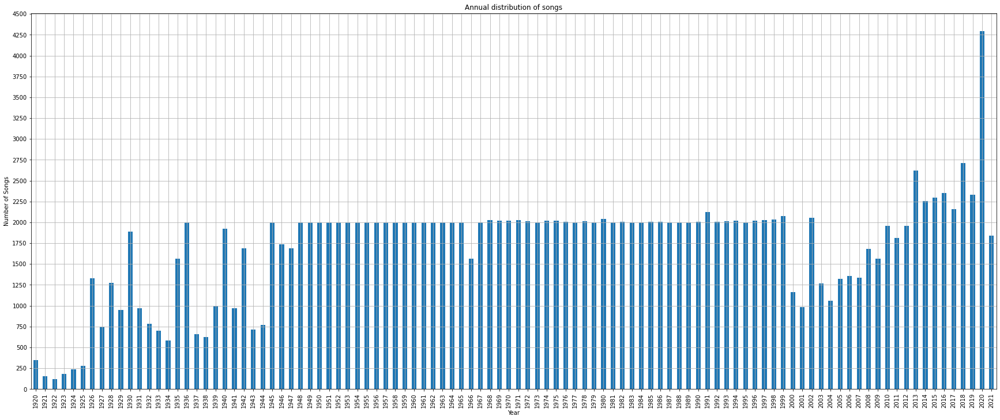

In [50]:
ax = df["year"].value_counts()[range(1920,2022)].plot(kind="bar", figsize=(30,12) ,rot=0)
ax.set_zorder('float')
ax.set_yticks(np.arange(0, 4501, 250))
ax.set_xticklabels(range(1920,2022), Rotation=90)
ax.set_xlabel('Year')
ax.set_ylabel('Number of Songs')
ax.set_title('Annual distribution of songs')
ax.grid(True);

In the period from 1920s to 1950s, "number of songs" did not show a linear increase or decrease. We can easily see a steady increase and decrease among the columns. In the period from 1950s to 2000s, "number of songs" is fixed to an almost constant value and does not increase or decrease. Although we saw a decreasing trend in the early 2000s, we see a gradual increasing trend after that. In 2020, "number of songs" saw the summit.

Text(0.5, 0, 'Year')

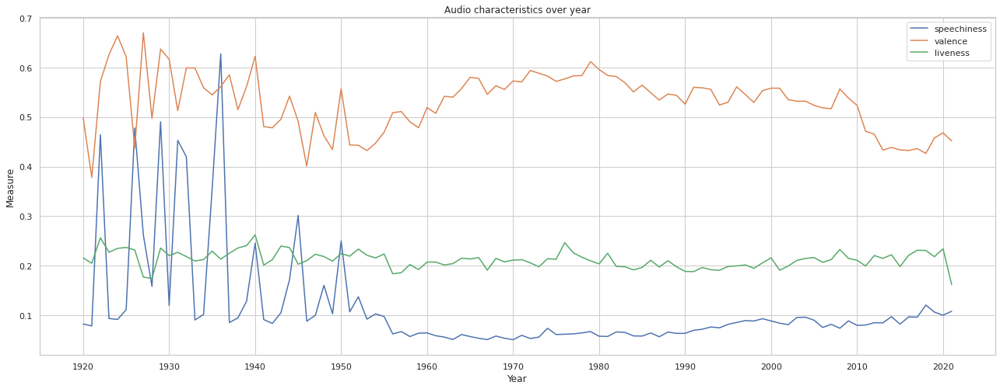

In [ ]:
plt.figure(figsize=(22, 8))
sns.set(style="whitegrid")
columns = ["speechiness","valence","liveness"]
for col in columns:
    x = df.groupby("year")[col].mean()
    ax = sns.lineplot(x=x.index,y=x,label=col)
ax.set_xticks(np.arange(1920, 2021, 10))
ax.set_title('Audio characteristics over year')
ax.set_ylabel('Measure')
ax.set_xlabel('Year')

Liveness: Although this value has very small increases and decreases fluctuations, it generally has a stable line.

Valence: This feature has fluctuated a lot over the years. We easily notice decreases and increases between the 0.4 and 0.7 values from the 1920s to the 1960s. It has less volatility from the 60s to the 2010s and took values between 0.5 and 0.6. Recently, there has been a slight decrease in its value.

Speechiness: We observe dramatic increases and decreases in the period from the 1920s to the 1950s. Its values from the 50s to the 2020s are much more stable compared to the previous period. It had a slight decline during this period, and then came to around 0.1.

Text(0.5, 0, 'Year')

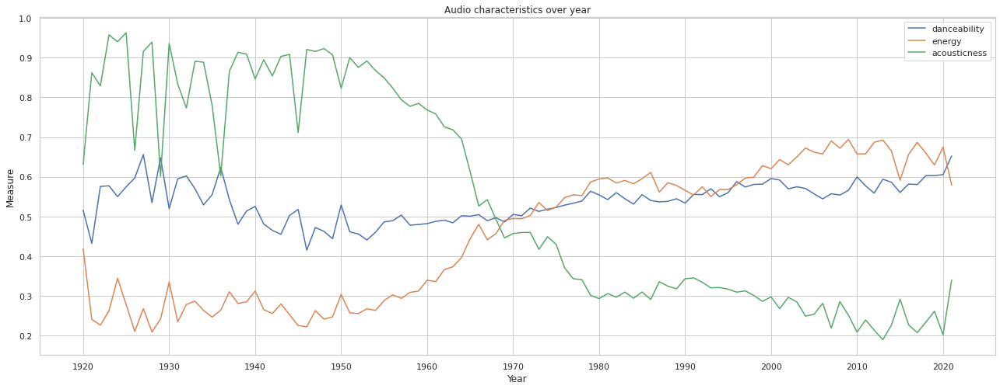

In [ ]:
plt.figure(figsize=(22, 8))
sns.set(style="whitegrid")
columns = ["danceability","energy","acousticness"]
for col in columns:
    x = df.groupby("year")[col].mean()
    ax = sns.lineplot(x=x.index,y=x,label=col)
ax.set_xticks(np.arange(1920, 2021, 10))
ax.set_title('Audio characteristics over year')
ax.set_ylabel('Measure')
ax.set_xlabel('Year')

Text(0, 0.5, 'Median energy')

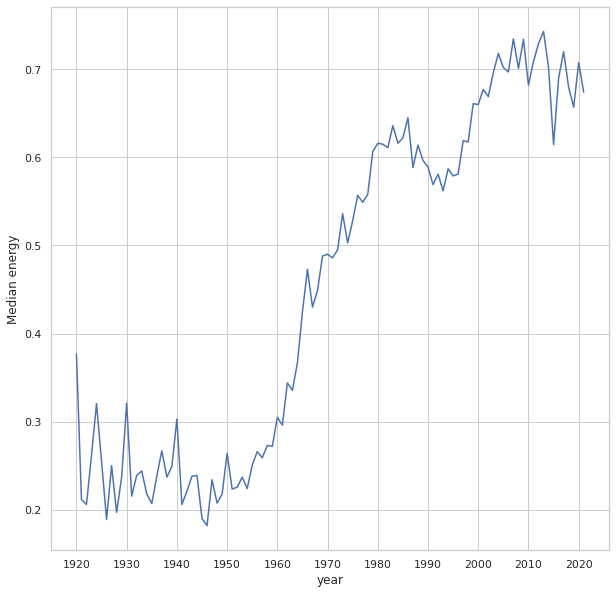

In [ ]:
plt.figure(figsize = (10,10))
plt.xticks(np.arange(1920, 2021, 10))
df.groupby('year')['energy'].median().plot()
plt.xlabel('year')
plt.ylabel('Median energy')

Large and short-term fluctuations were observed between the values of 0.2 and 0.4 between 1920 and 40, and a serious increase was observed in the years after 1940. Since the median value is the central value that divides the series into two when we rank the data series in ascending order, it can be said that the acousticness values added to the series over the years are greater than the current median value. Today it is around 0.7.

Text(0, 0.5, 'Median acousticness')

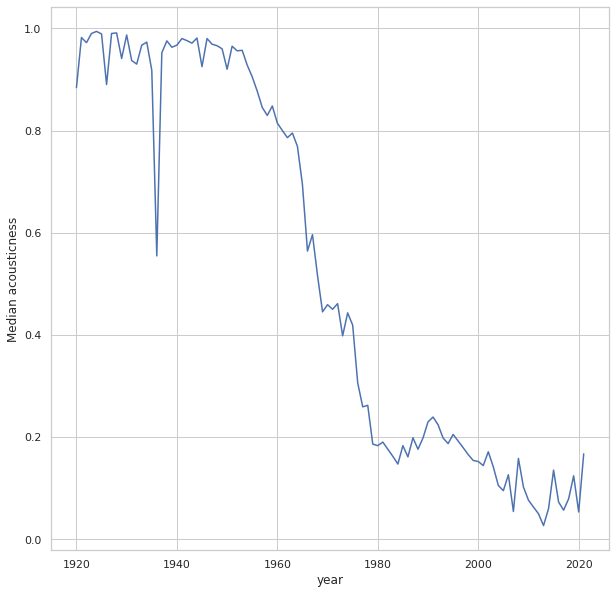

In [ ]:
plt.figure(figsize = (10,10))
df.groupby('year')['acousticness'].median().plot()
plt.xlabel('year')
plt.ylabel('Median acousticness')

While this value was 1 between 1920-40, it decreased dramatically over the years after 1940. Since the median value is the central value that divides the series into two when we rank the data series from small to large, it can be said that the acousticness values added to the series over the years are smaller than the current median value. Today it is worth 0.2.

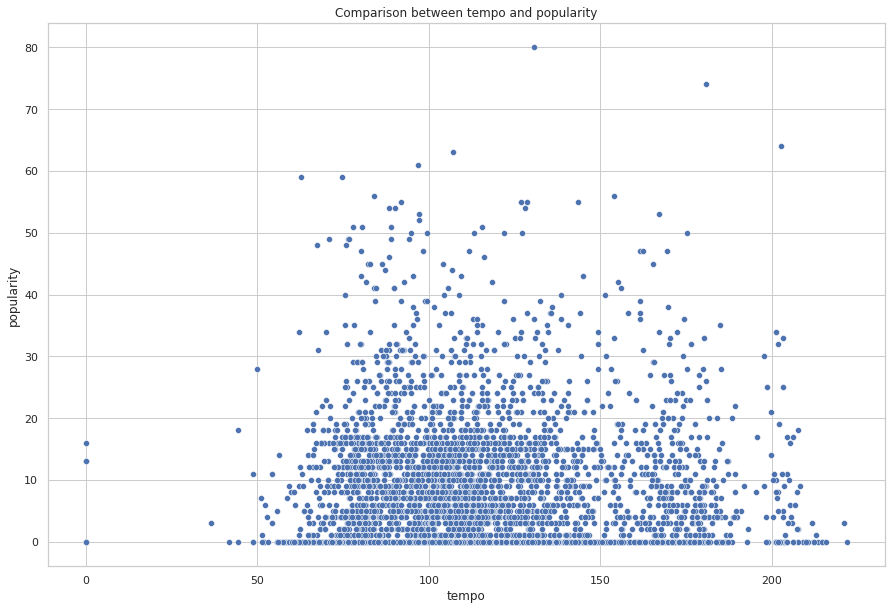

In [ ]:
d = df[:5000]
plt.figure(figsize=(15, 10))
sns.scatterplot('tempo','popularity',data=d)
plt.title('Comparison between tempo and popularity')
plt.show()

In the overall dataframe, we can observe that most popular songs has a bpm which is between around 75-130.

Text(0.5, 1.0, 'Comparison between danceability and popularity')

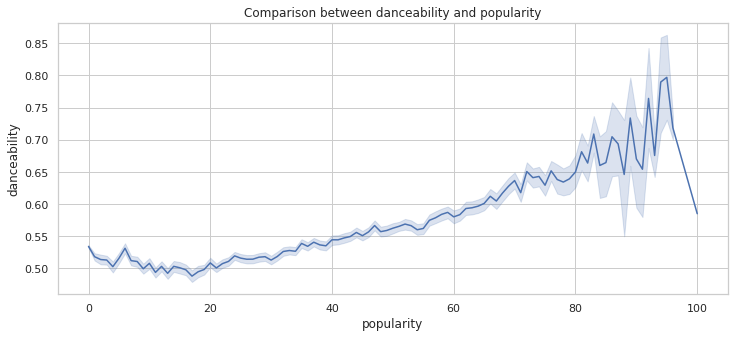

In [ ]:
plt.figure(figsize=(12, 5))
sns.lineplot(y = 'danceability', x = 'popularity', data = df)
plt.title('Comparison between danceability and popularity')

We can easily observe that danceability is directly proportional to the popularity. However the most popular ones generally has a mood of calm and tranquil.




---


**Analysis of the most popular artists and songs.**


---



(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 <a list of 10 Text major ticklabel objects>)

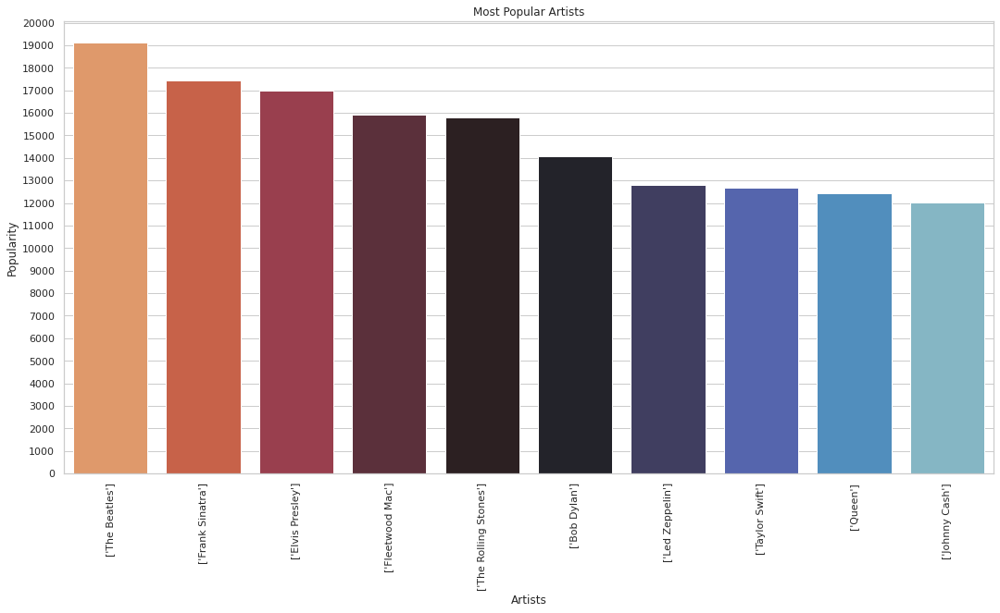

In [ ]:
plt.figure(figsize=(18, 9))
meas = df.groupby("artists")['popularity'].sum().sort_values(ascending=False)[:10]
axis = sns.barplot(meas.index,meas, palette='icefire_r')
axis.set_yticks(np.arange(0, 20001, 1000))
axis.set_title('Most Popular Artists')
axis.set_ylabel('Popularity')
axis.set_xlabel('Artists')
plt.xticks(rotation = 90)

As seen in the graph, the most popular artist is The Beatles with just over 1900, the second popular artist is Frank Sinatra with just over 1700 and the third popular artist is Elvis Presley with almost 1700 popularity.

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 <a list of 10 Text major ticklabel objects>)

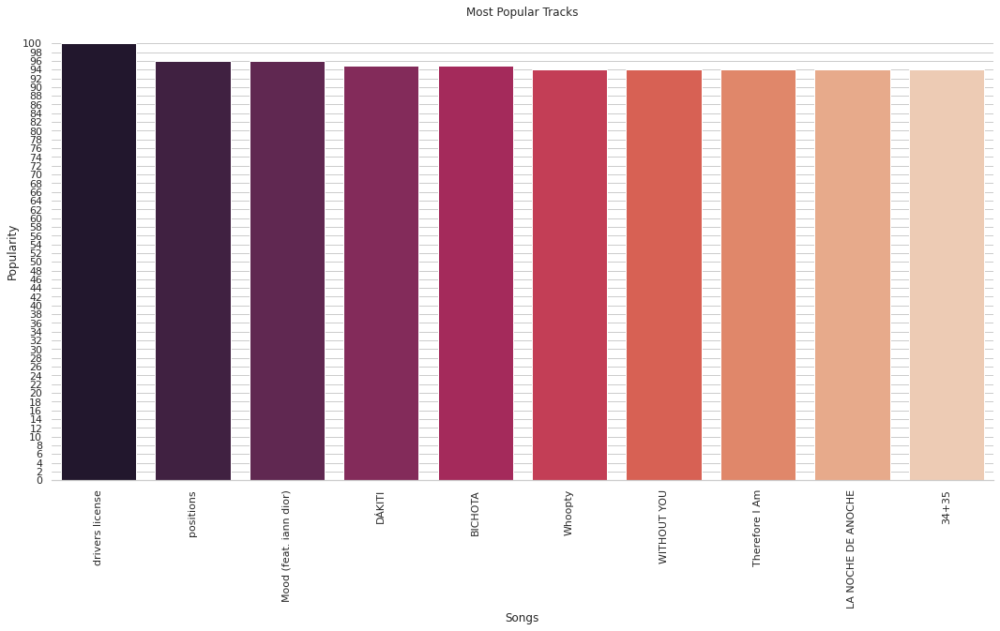

In [ ]:
plt.figure(figsize=(18, 9)) 
tempyear = df.sort_values('popularity', ascending=False).head(10)
tempyear = tempyear.reset_index()
tempyear = tempyear[['year', 'artists', 'name', 'popularity']]
names = tempyear.groupby("name")['popularity'].sum().sort_values(ascending=False)
axis = sns.barplot(names.index,names,palette='rocket')
sns.despine( left=True)
axis.set_yticks(np.arange(0, 101, 2))
axis.set_title('Most Popular Tracks')
axis.set_ylabel('Popularity')
axis.set_xlabel('Songs')
plt.xticks(rotation = 90)

As seen in the graph the most popular is drivers license by Olivia Rodrigo with 100 popularity, the second is poositiions by Ariana Grande with 96 popularity and the third is Mood (feat. iann dior) by 24kGoldn with 96 popularity.


---


**ANALYZING HOW SONGS OF DIFFERENT GENRES CHANGE WITH TIME**


---
At this stage, we will examine the changes in some features of 4 different music genres (disco, turkish folk, funk, soul) over the years.

In [ ]:
df['artists'] = df['artists'].apply(lambda x: re.findall(r'[\']([\w\s-]+)[\']', x))
df = df.explode("artists")

In [ ]:
merged = pd.merge(df, data_w_genres, on="artists")

Text(0.5, 1.0, 'Disco!')

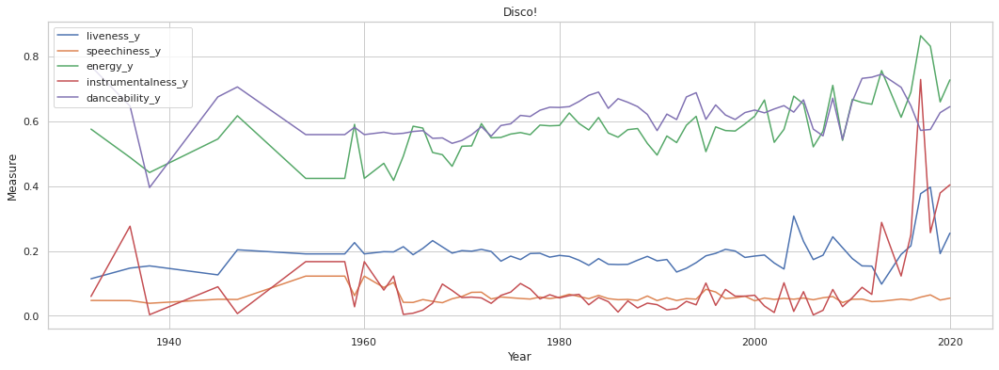

In [ ]:
merged1 = merged.loc[(merged["genres"].str.contains("'disco'"))]
plt.figure(figsize=(18, 6))
sns.set(style="whitegrid")
measurements = ["liveness_y","speechiness_y","energy_y","instrumentalness_y","danceability_y"]
for elem in measurements:
    temp = merged1.groupby("year")[elem].mean()
    ax = sns.lineplot(x=temp.index,y=temp,label=elem)

ax.set_xlabel('Year')
ax.set_ylabel('Measure')
ax.set_title('Disco!')

Danceability: In the period before 1940, it experienced a very sharp decline from 0.8 to 0.4. The danceability property of the disco music genre has been fixed at almost 0.6 in the period from that period to the present.

Energy: In the period up to 1960, it experienced ups and downs between 0.4 and 0.6. Although it has experienced constant fluctuations in value in the process extending from those periods to the present, it shows a linear increase in the long term.

Instrumentalness: It has a sudden rise and decrease in the period before 1940. It experienced severe fluctuations again between the periods of 1940 - 1960. In the period from the 60s to the 2010s, its value has almost stabilized at 0.1 levels. It has a dramatic increase in the period from that period to the present.

Speechiness: This feature of the Disco genre has not changed much over the years. We see that it is almost constant at a value of 0.1.

Liveness: This value is a fixed value of 0.2 until the 2000s. Its value has increased and decreased a lot in the period from that period to the present. The value, which increased up to 0.4s for a period, is now a little over 0.2.

Text(0.5, 1.0, 'Turkish Folk!')

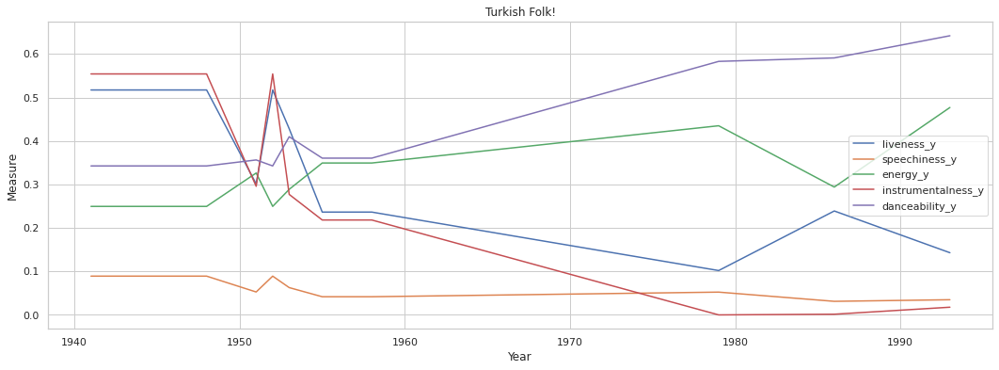

In [ ]:
merged2 = merged.loc[(merged["genres"].str.contains("'turkish folk'"))]
plt.figure(figsize=(18, 6))
sns.set(style="whitegrid")
measurements = ["liveness_y","speechiness_y","energy_y","instrumentalness_y","danceability_y"]
for elem in measurements:
    temp = merged2.groupby("year")[elem].mean()
    ax = sns.lineplot(x=temp.index,y=temp,label=elem)

ax.set_xlabel('Year')
ax.set_ylabel('Measure')
ax.set_title('Turkish Folk!')

Danceability: Having a constant value between 0.3 and 0.4 during the period until the 1960s, danceability has a continuous increase trend from the 60s to the 00s.

Energy: It is slightly increasing until 1980 period. Since then, it has dramatically decreased its value and then increased it back.

Instrumentalness: It increased and decreased suddenly after going constant until the 50s. After that period, its value has continuously decreased.

Speechiness: This feature of the Disco genre has not changed much over the years. We see that it is almost constant between 0.0 and 0.1 values.

Liveness: It had a value of 0.5 until the 1950s. Although it has experienced various fluctuations after that period, its general tendency is decreasing.

Text(0.5, 1.0, 'Funk!')

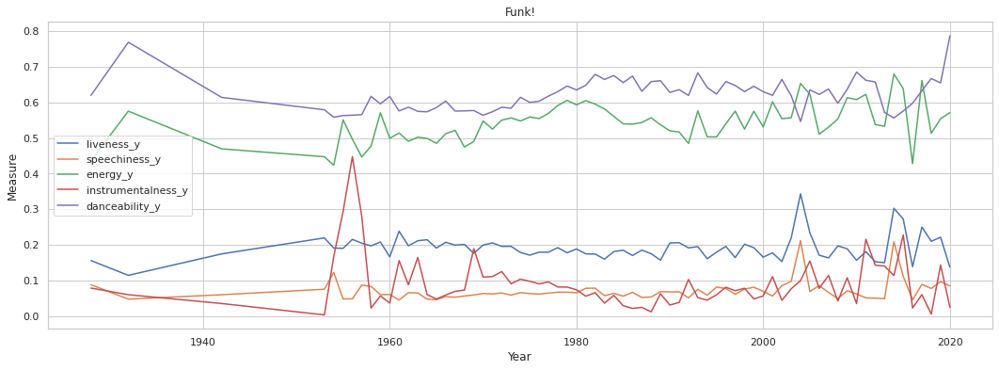

In [ ]:
merged4 = merged.loc[(merged["genres"].str.contains("'funk'"))]
plt.figure(figsize=(18, 6))
sns.set(style="whitegrid")
measurements = ["liveness_y","speechiness_y","energy_y","instrumentalness_y","danceability_y"]
for elem in measurements:
    temp = merged4.groupby("year")[elem].mean()
    ax = sns.lineplot(x=temp.index,y=temp,label=elem)

ax.set_xlabel('Year')
ax.set_ylabel('Measure')
ax.set_title('Funk!')

Danceability: This value, which was around 0.6 in 1920, approached 0.8 in 10 years, but decreased over time and was around 0.6 in about 100 years. However, it increased to 0.8 again in 2020.

Energy: The "Energy" lines is almost the same as the "Danceability" lines. This value, which was 0.45 in 1920, is over 0.5 today.

Liveness: It has been in constant value except for minor short fluctuations. While it was around 0.145 in 1920, it is still in the same value today.

Speechiness: This value was below 0.1 in the 1920s, but occasionally increased above 0.1. Today it is less than 0.1.

Instrumentalness: Large and long-term fluctuations have been observed over the years at this value, which was almost 0.0 in 1953. Despite large fluctuations, the 1920 and present values are very close, between 0.0 and 0.1.

Text(0.5, 1.0, 'Soul!')

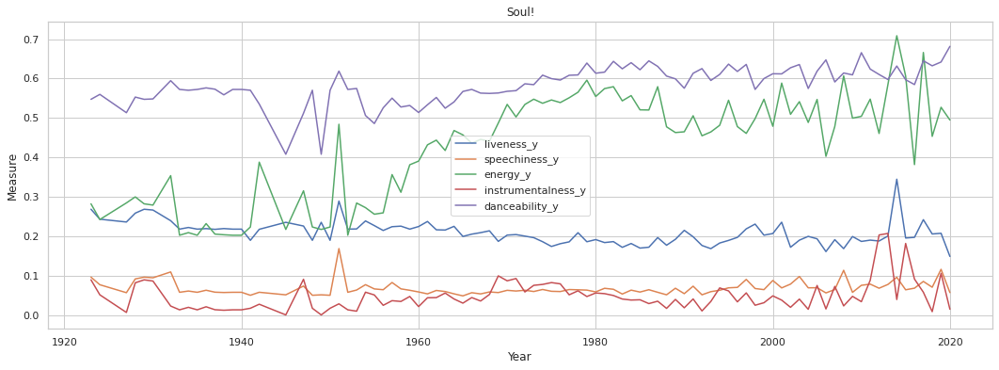

In [ ]:
merged5 = merged.loc[(merged["genres"].str.contains("'soul'"))]
plt.figure(figsize=(18, 6))
sns.set(style="whitegrid")
measurements = ["liveness_y","speechiness_y","energy_y","instrumentalness_y","danceability_y"]
for elem in measurements:
    temp = merged5.groupby("year")[elem].mean()
    ax = sns.lineplot(x=temp.index,y=temp,label=elem)

ax.set_xlabel('Year')
ax.set_ylabel('Measure')
ax.set_title('Soul!')

Danceability: While the "danceability" value was around 0.55 in 1920, the biggest fluctuation of the value occurred between the years 1940-60. Sudden fluctuations occurred between 0.4-0.6 values, but later turned into a linear increase and reached the value of 0.66 in 2020.

Energy: When we look at the "Energy" values, it can be seen that the fixed values ​​are almost nonexistent. There have been sudden ups and downs in every period since 1920. "Energy" value was around 0.28 in 1920 and 0.5 in 2020.

Liveness: The value of "Liveness" has not changed much since 1920. While it was above 0.2 in 1920, this value dropped to 0.2 in the next 100 years. There is a decreasing linear graph, but the decrease has been very slow.

Speechiness: Except for the severe fluctuation in 2010, the "Speechiness" value has a linear graph. "Speechines", which were worth 0.1 in 1920, came too close to 0.00 at times. In the following years, it reached the value of 0.1 again.

Instrumentalness: This value has not fluctuated and changed much for many years, such as the value of "liveness", while it was 0.1 in 1920, it is still around the same today.



---


**Comparison of features of sub-genres over time periods**


---



Text(0.5, 1.0, 'Modern Funk!')

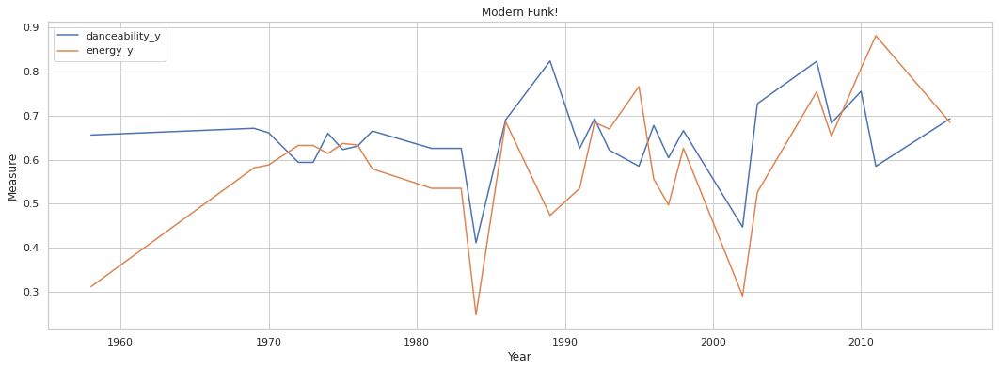

In [ ]:
merged6 = merged.loc[(merged["genres"].str.contains("'modern funk'"))]
plt.figure(figsize=(18, 6))
sns.set(style="whitegrid")
measurements = ["danceability_y","energy_y"]
for elem in measurements:
    temp = merged6.groupby("year")[elem].mean()
    ax = sns.lineplot(x=temp.index,y=temp,label=elem)

ax.set_xlabel('Year')
ax.set_ylabel('Measure')
ax.set_title('Modern Funk!')

As seen the graph, we can observe that ups and downs are mostly happened in the same years in parent genre of modern funk.

Text(0.5, 1.0, 'Funk Metal!')

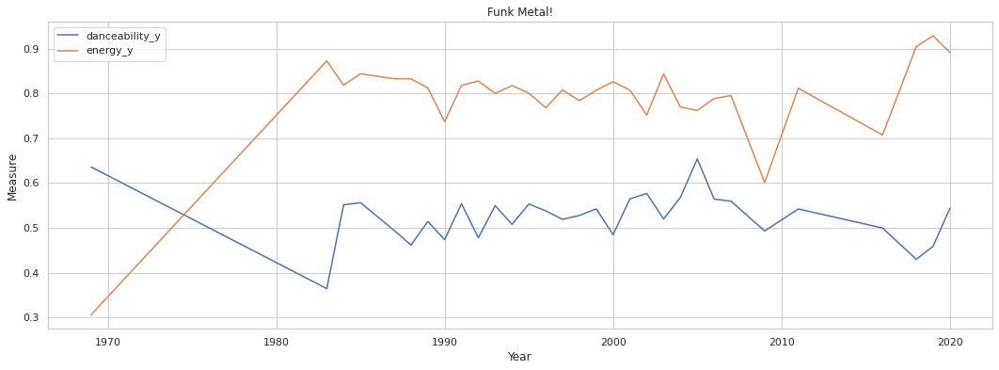

In [ ]:
merged8 = merged.loc[(merged["genres"].str.contains("funk metal'"))]
plt.figure(figsize=(18, 6))
sns.set(style="whitegrid")
measurements = ["danceability_y","energy_y"]
for elem in measurements:
    temp = merged8.groupby("year")[elem].mean()
    ax = sns.lineplot(x=temp.index,y=temp,label=elem)

ax.set_xlabel('Year')
ax.set_ylabel('Measure')
ax.set_title('Funk Metal!')

As seen in the graph, energy and danceablility measure in funk metal genre generally move in opposite directions to each other.

Text(0.5, 1.0, 'British Soul!')

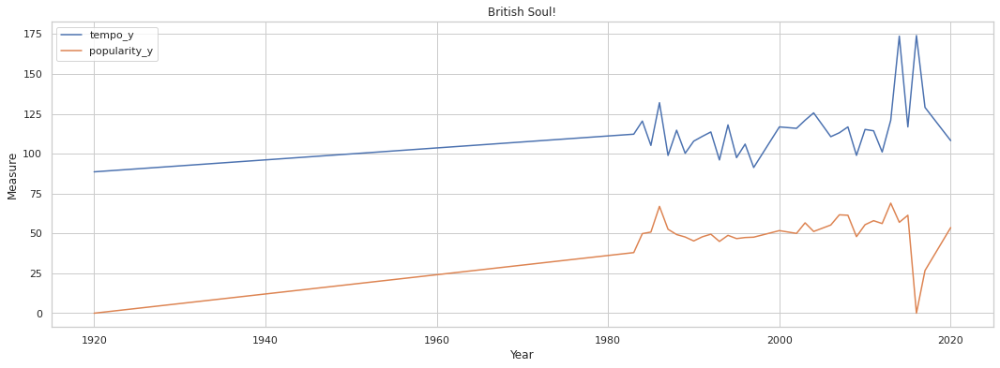

In [ ]:
merged9 = merged.loc[(merged["genres"].str.contains("'british soul'"))]
plt.figure(figsize=(18, 6))
sns.set(style="whitegrid")
measurements = ["tempo_y","popularity_y"]
for elem in measurements:
    temp = merged9.groupby("year")[elem].mean()
    ax = sns.lineplot(x=temp.index,y=temp,label=elem)

ax.set_xlabel('Year')
ax.set_ylabel('Measure')
ax.set_title('British Soul!')

Text(0.5, 1.0, 'Classic Soul!')

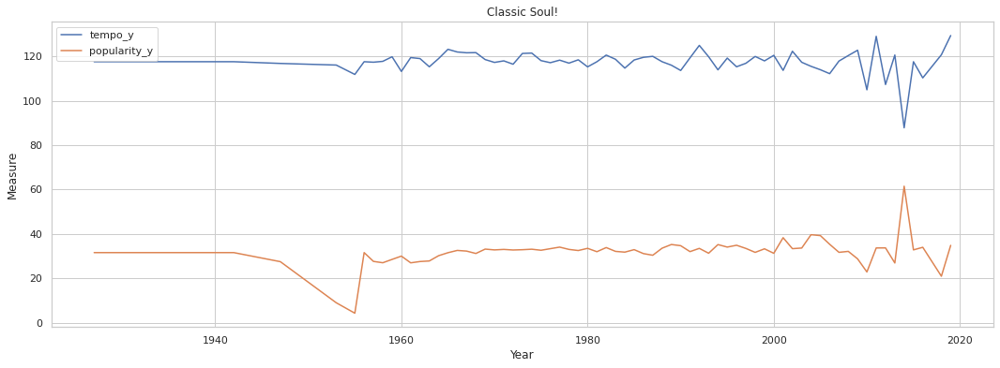

In [ ]:
merged10 = merged.loc[(merged["genres"].str.contains("'classic soul'"))]
plt.figure(figsize=(18, 6))
sns.set(style="whitegrid")
measurements = ["tempo_y","popularity_y"]
for elem in measurements:
    temp = merged10.groupby("year")[elem].mean()
    ax = sns.lineplot(x=temp.index,y=temp,label=elem)

ax.set_xlabel('Year')
ax.set_ylabel('Measure')
ax.set_title('Classic Soul!')

We can observe that classical soul is an genre that maintains almost the same popularity and tempo since 1920's. However, british soul was a fresh out genre about 1980's and it passed the classical soul immediately in terms of popularity.

### **Hypothesis Testing**

In [ ]:
df.describe()

,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,valence,year
count,229540.000000,229540.000000,2.295400e+05,229540.000000,229540.000000,229540.000000,229540.000000,229540.000000,229540.000000,229540.000000,229540.000000,229540.000000,229540.000000,229540.000000,229540.000000
mean,0.549971,0.519929,2.392904e+05,0.450814,0.068785,0.221009,5.178431,0.214696,-12.473253,0.701385,23.579973,0.106806,115.411927,0.494788,1975.397369
std,0.385812,0.184887,1.563314e+05,0.277079,0.253089,0.349366,3.511733,0.182460,6.140914,0.457651,22.144985,0.180134,30.421248,0.271465,27.679481
min,0.000000,0.000000,4.937000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1920.000000
25%,0.120750,0.386000,1.653138e+05,0.212000,0.000000,0.000001,2.000000,0.100000,-16.109000,0.000000,0.000000,0.036200,91.765000,0.264000,1952.000000
50%,0.644000,0.530000,2.075330e+05,0.416000,0.000000,0.000953,5.000000,0.140000,-11.534000,1.000000,21.000000,0.046200,113.983500,0.500000,1974.000000
75%,0.943000,0.661000,2.727902e+05,0.680000,0.000000,0.413000,8.000000,0.275000,-7.775000,1.000000,40.000000,0.078000,133.820000,0.720000,1999.000000
max,0.996000,0.988000,5.338302e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.971000,243.507000,1.000000,2021.000000


# Hypothesis 1: 
(Statistical tests to check how (or if) features contribute to popularity of songs)

---

At this stage, we will articulate *tempo*'s feature. 

***Null Hypothesis:***

Tempo has no effect on popularity of the song.

# Process
While we were examining the effect of tempo on popularity, we did it by dividing it into two groups with a bound of 25.6 which is mean of the popularity. Also We will use T-test to determine their relationship.

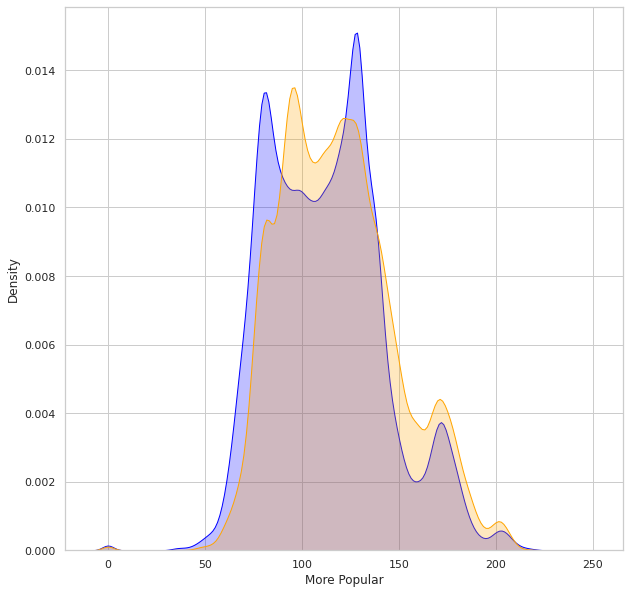

In [ ]:
less_popular_df = df[df["popularity"] <= 25.6]	
more_popular_df = df[df["popularity"] > 25.6]	

fig, ax = plt.subplots(1,1, figsize=(10,10))

ax = sns.kdeplot(less_popular_df["tempo"].rename("More Popular"), shade=True, color='blue')
sns.kdeplot(more_popular_df["tempo"].rename("Higher than Mean"),  ax=ax, shade=True, color='orange')

plt.show()

In [ ]:
signifance=0.05
less_popular_songs = less_popular_df["tempo"].between(0,243)
more_popular_songs = more_popular_df["tempo"].between(0,243)

_, p_value = stats.ttest_ind(a=less_popular_songs, b=more_popular_songs, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance Level:", signifance)
if (p_value < signifance):
  print("Based on current value of p value we reject null hypothesis, tempo affects popularity.")
else:
   print("Based on current value of p value we fail to reject null hypothesis, tempo does not affect popularity.")

P value:  1.57E-01
Signifance Level: 0.05
Based on current value of p value we fail to reject null hypothesis, latitude does not affect price.


At this stage, we will articulate *loudness*'s feature. 

***Null Hypothesis:***

Loudness has no effect on popularity of the song.

# Process
While we were examining the effect of tempo on popularity, we did it by dividing it into two groups with a bound of 25.6 which is mean of the popularity. Also We will use T-test to determine their relationship.

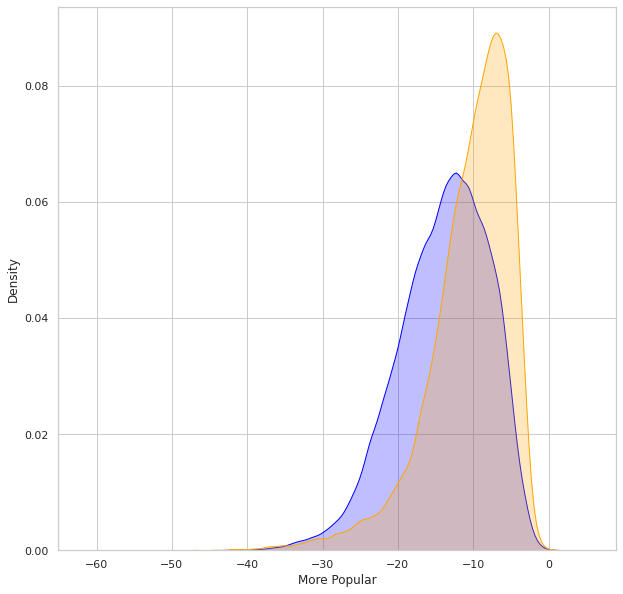

In [ ]:
less_popular_df1 = df[df["popularity"] <= 25.6]	
more_popular_df1 = df[df["popularity"] > 25.6]	

fig, ax = plt.subplots(1,1, figsize=(10,10))

ax = sns.kdeplot(less_popular_df1["loudness"].rename("More Popular"), shade=True, color='blue')
sns.kdeplot(more_popular_df1["loudness"].rename("Higher than Mean"),  ax=ax, shade=True, color='orange')

plt.show()

In [ ]:
signifance=0.05
less_popular_songs1 = less_popular_df1["loudness"].between(0,243)
more_popular_songs2 = more_popular_df1["loudness"].between(0,243)

_, p_value = stats.ttest_ind(a=less_popular_songs1, b=more_popular_songs2, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance Level:", signifance)
if (p_value < signifance):
  print("Based on current value of p value we reject null hypothesis, loudness affects popularity.")
else:
   print("Based on current value of p value we fail to reject null hypothesis, loudness does not affect popularity.")

P value:  2.08E-01
Signifance Level: 0.05
Based on current value of p value we fail to reject null hypothesis, loudness does not affect popularity.


# Hypothesis 2: 
(Statistical tests to check if significant differences exist between different eras)

---

In this case, we analyzed the change in the danceability and energy features of the hip hop genre between the 80's and 00's.

***Null Hypothesis:***

There is no significant differences exist between different eras.

# Process
While checking whether there are significant differences between different periods, we aimed to combine the necessary data files and see the effect of the properties we have selected on the periods. In this scenario, we wanted to see the effect of danceability and energy on hiphop's 80's and 00's change over time.

In [ ]:
path = r'/content/drive/My Drive/CS210'
all_files = glob.glob(os.path.join(path, "*.csv"))

df_from_each_file = (pd.read_csv(f) for f in all_files)
concatenated_df   = pd.concat(df_from_each_file, ignore_index=True)

Text(0.5, 1.0, 'Hip Hop!')

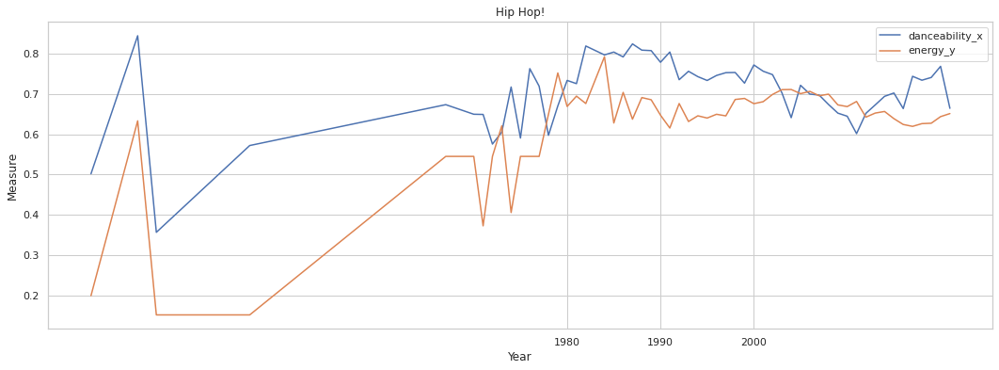

In [ ]:
merged111 = merged.loc[(merged["genres"].str.contains("'hip hop'"))]
plt.figure(figsize=(18, 6))
sns.set(style="whitegrid")
measurements = ["danceability_x","energy_y"]
for elem in measurements:
    temp = merged111.groupby("year")[elem].mean()
    ax = sns.lineplot(x=temp.index,y=temp,label=elem)

ax.set_xticks(np.arange(1980, 2001, 10))
ax.set_xlabel('Year')
ax.set_ylabel('Measure')
ax.set_title('Hip Hop!')

In [ ]:
signifance=0.05
a = merged111[merged111["year"] <= 1990]	
b = merged111[merged111["year"] >= 1990]	

deneme1 = a["energy_y"]
deneme2 = b["energy_y"]

_, p_value = stats.ttest_ind(a=deneme1, b=deneme2, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance Level:", signifance)

if (p_value < signifance):
  print("Based on current value of p value we reject null hypothesis, There is significant differences exist between different eras in terms of energy.")
else:
   print("Based on current value of p value we fail to reject null hypothesis, There is no significant differences exist between different eras in terms of energy.")

P value:  1.59E-01
Signifance Level: 0.05
Based on current value of p value we fail to reject null hypothesis, There is no significant differences exist between different eras in terms of energy.


In [ ]:
signifance=0.05
a1 = merged111[merged111["year"] <= 1990]	
b1 = merged111[merged111["year"] >= 1990]	

deneme11 = a1["danceability_x"]
deneme22 = b1["danceability_x"]

_, p_value = stats.ttest_ind(a=deneme11, b=deneme22, equal_var=False)
print("P value: ",format(p_value,".2E"))
print("Signifance Level:", signifance)

if (p_value < signifance):
  print("Based on current value of p value we reject null hypothesis, There is significant differences exist between different eras in terms of danceability.")
else:
   print("Based on current value of p value we fail to reject null hypothesis, There is no significant differences exist between different eras in terms of danceability.")

P value:  8.41E-12
Signifance Level: 0.05
Based on current value of p value we reject null hypothesis, There is significant differences exist between different eras in terms of danceability.


---

# **MACHINE LEARNING**

---


In [45]:
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
import plotly.express as px 
from sklearn.decomposition import PCA
from collections import OrderedDict
import tqdm

In [ ]:
df1 = pd.read_csv(join(path_prefix, filename))
clustersong = Pipeline([('scaler', StandardScaler()),('kmeans', KMeans(n_clusters=20, verbose=2, n_jobs=4))], verbose=True)
X = df1.select_dtypes(np.number)
clustersong.fit(X)
song_cluster_labels = clustersong.predict(X)
df1['cluster_label'] = song_cluster_labels

[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.1s
[Pipeline] ............ (step 2 of 2) Processing kmeans, total=  38.6s


In [ ]:
plt.figure(figsize=(16, 15))
compon = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
combiningsong = compon.fit_transform(X)
graph = pd.DataFrame(columns=['X Axis', 'Y Axis'], data=combiningsong)
graph['title'] = df1['name']
graph['cluster'] = df1['cluster_label']
fig = px.scatter(graph, x='X Axis', y='Y Axis', color='cluster', hover_data=['X Axis', 'Y Axis', 'title'])
fig.show()

<Figure size 720x1080 with 0 Axes>

We clustered the songs according to similar features. In the graph, the clustered music is shown in different colors.

In [55]:
df_recommend = pd.read_csv(join(path_prefix, filename))

In [56]:
def scale_0_1(df, col):
    df_recommend.loc[:, col] = (df_recommend[col]-df_recommend[col].mean())/df_recommend[col].std()

In [57]:
attrs = ["acousticness", "danceability", "energy", "instrumentalness", "liveness", "loudness", "speechiness", "tempo", "valence"]
for attr in attrs:
    scale_0_1(df_recommend, attr) # Rescale these attributes to be N(0, 1)
df_recommend.loc[:, "name"] = df_recommend["name"].str.lower()
csv = df_recommend.drop_duplicates(subset=attrs)

In [58]:
inputname = input("Please enter a song name for recommendations: ")
limit = int(input("Please enter how many song do you want: "))
rows = csv[["name", "id", "artists"]+attrs][csv["name"].str.contains(inputname)]
array1 = rows[attrs].iloc[2].to_numpy()

recommendedSongs = OrderedDict()
for index, row in tqdm.tqdm(csv.iterrows()):
    array2 = row[attrs].to_numpy()
    distance = ((array1 - array2)**2).mean() 
    recommendedSongs[distance] = row[["name", "artists"]]


for k, v in sorted(recommendedSongs.items(), key=lambda x:x[0]):
    if k > 0.05 or limit == 0: break
    print(k, v['name'], v['artists'])
    limit -=1

Please enter a song name for recommendations: respect
Please enter how many song do you want: 5


167358it [02:26, 1139.07it/s]


0.0 a little respect ['Erasure']
0.02286541331519054 when you walk in the room ['Paul Carrack']
0.023824658502297678 i've always been crazy ['Waylon Jennings']
0.02879770571058861 give me all night ['Carly Simon']
0.029284812829529192 don't ask me questions ['Graham Parker & The Rumour']


For music recommendation system the song name is taken as input from the user and similar musics are recommended limitedly by the program. This limit is determined by the user.

In [22]:
ml_df = pd.read_csv(join(path_prefix, filename))
ml_df.drop(['id', 'name', 'artists', 'release_date', 'duration_ms'], axis = 1, inplace = True)
ml_df.columns

Index(['acousticness', 'danceability', 'energy', 'explicit',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity',
       'speechiness', 'tempo', 'valence', 'year'],
      dtype='object')

In [27]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
X= ml_df.loc[:,ml_df.columns!='popularity']
y= ml_df.loc[:,ml_df.columns=='popularity']

scaled_X= StandardScaler()
scaled_y= StandardScaler()
X=scaled_X.fit_transform(X)
y=scaled_y.fit_transform(y)
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.25, random_state=0)

In [28]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
regressor_lin=LinearRegression()
regressor_lin.fit(X_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [32]:
predicted_y_lin = regressor_lin.predict(X_test)

In [61]:
print("Linear Regression >>> Training Score: {}\n".format(regressor_lin.score(X_train, y_train)))
print("Linear Regression >>> R2 Score: {}\n".format(r2_score(y_test, predicted_y_lin)))
print("Linear Regression >>> Mean Squared Error: {}\n".format(mean_squared_error(y_test, predicted_y_lin)))
print("Linear Regression >>> Mean Absolute Error: {}\n".format(mean_absolute_error(y_test, predicted_y_lin)))

Linear Regression >>> Training Score: 0.3645480071783703

Linear Regression >>> R2 Score: 0.3607038038094895

Linear Regression >>> Mean Squared Error: 0.6386907522635533

Linear Regression >>> Mean Absolute Error: 0.6173983346461942



In [62]:
from sklearn.tree import DecisionTreeRegressor
regressor_dt= DecisionTreeRegressor(random_state=0)
regressor_dt.fit(X_train,y_train)

predicted_y_decisiontree = regressor_dt.predict(X_test)

print("Decision Tree Regressor >>> Training Score: {}\n".format(regressor_dt.score(X_train, y_train)))
print("Decision Tree Regressor >>> R2 Score: {}\n".format(r2_score(y_test, predicted_y_decisiontree)))
print("Decision Tree Regressor >>> Mean Squared Error: {}\n".format(mean_squared_error(y_test, predicted_y_decisiontree)))
print("Decision Tree Regressor >>> Mean Absolute Error: {}\n".format(mean_absolute_error(y_test, predicted_y_decisiontree)))

Decision Tree Regressor >>> Training Score: 0.9981042449725023

Decision Tree Regressor >>> R2 Score: 0.36115797533323346

Decision Tree Regressor >>> Mean Squared Error: 0.63823701086186

Decision Tree Regressor >>> Mean Absolute Error: 0.48751252792140637



In [63]:
from sklearn.ensemble import RandomForestRegressor
regressor_rf=RandomForestRegressor(n_estimators=300, random_state=0)
regressor_rf.fit(X_train,y_train)

predicted_y_randomforest = regressor_rf.predict(X_test)

print("randomForest Regression >>> Training Score: {}\n".format(regressor_rf.score(X_train, y_train)))
print("randomForest Regression >>> R2 Score: {}\n".format(r2_score(y_test, predicted_y_randomforest)))
print("randomForest Regression >>> Mean Squared Error: {}\n".format(mean_squared_error(y_test, predicted_y_randomforest)))
print("randomForest Regression >>> Mean Absolute Error: {}\n".format(mean_absolute_error(y_test, predicted_y_randomforest)))

randomForest Regression >>> Training Score: 0.9549572503489975

randomForest Regression >>> R2 Score: 0.6797217091472721

randomForest Regression >>> Mean Squared Error: 0.3199749720667121

randomForest Regression >>> Mean Absolute Error: 0.3798924042499437



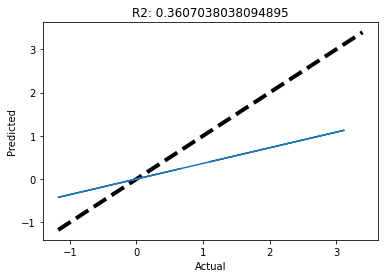

In [64]:
fig, ax = plt.subplots()
ax.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=4)
ax.set_xlabel('Actual')
ax.set_ylabel('Predicted')
y_test, y_predicted = y_test.reshape(-1,1), predicted_y_lin.reshape(-1,1)
ax.plot(y_test, LinearRegression().fit(y_test, predicted_y_lin).predict(y_test))
ax.set_title('R2: ' + str(r2_score(y_test, y_predicted)))
plt.show()

In the upcoming cells, GridSearchCV will be used to find the optimal hyperparameters for the decision tree in order to predict song popularity.

In [65]:
from sklearn.model_selection import GridSearchCV
featuresCount = X.shape[1]
samplesCount = X.shape[0]
 
grid = GridSearchCV(DecisionTreeRegressor(random_state=0), cv=3, n_jobs=-1, verbose=5, param_grid ={
                    'max_depth': [None,5,6,7,8,9,10,11], 'max_features': [None, 'sqrt', 'auto', 'log2', 0.3,0.5,0.7, featuresCount//2, featuresCount//3, ],
                    'min_samples_split': [2,0.3,0.5, samplesCount//2, samplesCount//3, samplesCount//5], 'min_samples_leaf':[1, 0.3,0.5, samplesCount//2, samplesCount//3, samplesCount//5]},)
 
grid.fit(X_train, y_train)
print('Train R^2 Score : %.3f'%grid.best_estimator_.score(X_train, y_train))
print('Test R^2 Score : %.3f'%grid.best_estimator_.score(X_test, y_test))
print('Best R^2 Score Through Grid Search : %.3f'%grid.best_score_)

Fitting 3 folds for each of 2592 candidates, totalling 7776 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done  84 tasks      | elapsed:    8.8s
[Parallel(n_jobs=-1)]: Done 589 tasks      | elapsed:   31.9s
[Parallel(n_jobs=-1)]: Done 1136 tasks      | elapsed:   56.9s
[Parallel(n_jobs=-1)]: Done 2018 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 3183 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done 4580 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done 6099 tasks      | elapsed:  4.2min
[Parallel(n_jobs=-1)]: Done 7776 out of 7776 | elapsed:  5.3min finished


Train R^2 Score : 0.636
Test R^2 Score : 0.601
Best R^2 Score Through Grid Search : 0.598


in training set, R2 means that something about how much of the variance within your sample is explained by the model, while computing it on the test set means that something about the predictive quality of your model. Here, R2 training and R2 test values are almost same. So it means our model is generalized well.

In [60]:
decision_tree = DecisionTreeRegressor(max_depth=8, max_features=None, min_samples_leaf=1, min_samples_split=2, random_state=0)
decision_tree.fit(X_train, y_train)
predicted_values = decision_tree.predict(X_test)
maeofvalues = mean_absolute_error(y_test, predicted_values)
print(f'Mean absolute error of this model: {maeofvalues:.3f}')

Mean absolute error of this model: 0.432


"Mean absolute error" is an index showing the performance of the model developed in artificial neural networks. The closer this value is to zero, the better the predictive ability of the model.